In [220]:
import networkx as nx
import csv 
import numpy as np
import random
import copy
import math 
from sklearn.cluster import SpectralClustering, KMeans
from sklearn.metrics import pairwise_distances
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics.pairwise import euclidean_distances
import pickle
import scipy
import ast

## Functions that are needed

In [221]:
def graph_communities(G, list_nodes_G):
    maj_no = 0
    min_no = 0
    for u in range(len(list_nodes_G)):
        if G.nodes[list_nodes_G[u]]['color'] == 'b':
            maj_no += 1
        else:
            min_no += 1
    return maj_no, min_no

In [222]:
def compute_avg_kdistance_cl_contribution(my_cluster, km_distances,node_index):
    # distance between node and the cluster center of cluster j
    return km_distances[node_index][my_cluster]

In [238]:
def cluster_proportions(G, list_nodes_G, no_clusters, cluster_assignment):
    # sizes of clusters                                                                                                    
    unique, counts = np.unique(cluster_assignment, return_counts=True)
    cluster_sizes = dict(zip(unique, counts))
    # cluster_proportion is a dictionary mapping from the clusters to the proportion of the majority nodes in each cluster 
    cluster_proportion = {}
    # cluster_majority is a dictionary mapping from the clusters to the number of the majority nodes in each cluster
    cluster_majority = {}
    # cluster_mminority is a dictionary mapping from the clusters to the number of the minority nodes in each cluster
    cluster_minority = {}
    for kk in range(no_clusters):
        cluster_proportion[kk] = 0
        cluster_majority[kk] = 0
        cluster_minority[kk] = 0

    for u in range(len(list_nodes_G)):
        if G.nodes[list_nodes_G[u]]['color'] == 'b':
            cluster_proportion[cluster_assignment[u]] += 1
            cluster_majority[cluster_assignment[u]] += 1
        else:
            cluster_minority[cluster_assignment[u]] += 1

    for kk in range(no_clusters):
        if kk not in cluster_sizes.keys(): 
            cluster_proportion[kk] = 0
        else:
            cluster_proportion[kk] /= cluster_sizes[kk]
    return cluster_sizes, cluster_proportion, cluster_majority, cluster_minority


In [224]:
def size_of_partition(part, no_clusters): 
    size_p_maj = 0
    size_p_min = 0
    # _, _, cluster_majority, cluster_minority = cluster_proportions(G, list_nodes_G, no_clusters, cluster_assignment)
    for j in range(no_clusters):
        size_p_maj += part[j][0]
        size_p_min += part[j][1]
    return size_p_maj, size_p_min, size_p_min + size_p_maj


In [225]:
def is_partition_valid_clustering(G, list_nodes_G, no_clusters, cluster_assignment): 
    maj_no, min_no = graph_communities(G, list_nodes_G)
    size_p_maj, size_p_min, total_size_p = size_of_partition(G, list_nodes_G, no_clusters, cluster_assignment)
    if maj_no == size_p_maj and min_no == size_p_min:
        return True
    else:
        return False

In [226]:
def is_partition_valid(part, G, list_nodes_G, no_clusters, S): 
    if len(S) == 0:
        return True 
    
    maj_no = 0
    min_no = 0
    for i in S:
        if G.nodes[list_nodes_G[i]]['color'] == 'b':
            maj_no += 1
        else:
            min_no += 1

    size_p_maj, size_p_min, _ = size_of_partition(part, no_clusters)
    if maj_no == size_p_maj and min_no == size_p_min:
        return True
    else:
        return False

In [227]:

def compute_centroids_manually(U_matrix, cluster_assignment, no_of_clusters):
    new_centers = []
    for kk in range(no_of_clusters):
        kk_center = list(np.mean(U_matrix[np.where(cluster_assignment == kk)[0],:],axis=0))
        new_centers.append(kk_center)
    return new_centers
    
def compute_km_distances(points, centroids, no_of_clusters):
    """
    Euclidean distance between point & data.
    Point has dimensions (m,), data has dimensions (n,m), and output will be of size (n,).
    """
    
    X_dist_new = []
    for point in points: 
        zz = []
        for kk in range(no_of_clusters):
            zz.append(np.sum((point - centroids[kk])**2))
        X_dist_new.append(zz)
    return np.array(X_dist_new)

# the function compute_fairness_linear() computes a linear fairness metric defined as abs(#R in cluster - #B in cluster times (1-p)/p), where p = |B| / (|R| + |B|) in the general graph G
def compute_fairness_linear(G, list_nodes_G, no_clusters, cluster_assignment):
    fairness_clusters = {}
    [cluster_sizes, cluster_proportion, cluster_majority, cluster_minority] = cluster_proportions(G,list_nodes_G, no_clusters, cluster_assignment)
    [maj_no, min_no] = graph_communities(G, list_nodes_G)
    maj_prop = maj_no / (maj_no + min_no)
    for kk in range(no_clusters):
        fairness_clusters[kk] = abs(cluster_minority[kk]- cluster_majority[kk]* (1 - maj_prop)/maj_prop)
 
    fairness_overall = np.sum(list(fairness_clusters.values()))
    fairness_overall = np.round(fairness_overall, 6)
    return fairness_clusters, fairness_overall



# the function compute_fairness_avgprop() computes the average fairness as defined by balance for a clustering as defined in https://proceedings.neurips.cc/paper_files/paper/2017/file/978fce5bcc4eccc88ad48ce3914124a2-Paper.pdf

def compute_balance_minprop(G, list_nodes_G, no_clusters, cluster_assignment):
    fairness_clusters = {}
    [cluster_sizes, cluster_proportion, cluster_majority, cluster_minority] = cluster_proportions(G,list_nodes_G, no_clusters, cluster_assignment)
    #[maj_no, min_no] = graph_communities(G, list_nodes_G)
    #maj_prop = maj_no / (maj_no + min_no)
    for kk in range(no_clusters):
        fairness_clusters[kk] = min(cluster_proportion[kk], 1 - cluster_proportion[kk])
 
    # fairness_overall = min(list(fairness_clusters.values()))
    fairness_overall = np.mean(list(fairness_clusters.values()))
    
    return fairness_clusters, fairness_overall


# the function compute_fairness_avgprop() computes the average fairness similar to balance for a clustering as defined in http://proceedings.mlr.press/v97/kleindessner19b.html (avg balance)
def compute_fairness_avgprop(G, list_nodes_G, no_clusters, cluster_assignment):
    fairness_clusters = {}
    [cluster_sizes, cluster_proportion, cluster_majority, cluster_minority] = cluster_proportions(G,list_nodes_G, no_clusters, cluster_assignment)
    [maj_no, min_no] = graph_communities(G, list_nodes_G)
    maj_prop = maj_no / (maj_no + min_no)
    for kk in range(no_clusters):
        fairness_clusters[kk] = abs(cluster_proportion[kk]- maj_prop)
 
    fairness_overall = np.mean(list(fairness_clusters.values()))
    return fairness_clusters, fairness_overall

def compute_centroids(G, list_nodes_G, no_clusters, cluster_assignment,myU):
    list_centroids = []
    for kk in range(no_clusters):
        list_centroids.append(myU[np.where(cluster_assignment==kk),:][0].mean(axis=0))
    return list_centroids

# the function compute_avg_kdistance_cl() computes the average distance to the k-means center obtained from the kmeans algorithm for a specified cluster
# note: this is what k-means optimizes for 
def compute_avg_kdistance_cl_inertia(cluster_assignmentx, my_cluster, km_distances):
    sumdist = km_distances[np.where(cluster_assignmentx==my_cluster)][:,my_cluster].sum()
    return sumdist

# the function compute_avg_kdistance() computes the average distance of all clusters to their respective k-means centers obtained from the kmeans algorithm
# note: this is what k-means optimizes for 
def compute_avg_kdistance_inertia(cluster_assignmentx, no_clusters, km_distances):
    dist_clusters = {}
                                                                                                     
    for kkk in range(no_clusters):
        dist_clusters[kkk] = (km_distances[np.where(cluster_assignmentx==kkk)][:,kkk]).sum()
    sumdist = np.sum(list(dist_clusters.values()))
    return dist_clusters, sumdist



### Data reading

In [2]:
### the following section reads in one of the datasets: APS, Facebook, Highschool; uncomment for the data desired to use
'''#APS dataset: 
filename = 'APS-clusteringgames-utilities-conductance.csv'

# read in the data as a graph
G_og = nx.read_gexf('Downloads/clustering_plotting/APS/sampled_APS_pacs052030.gexf')

# work with the largest connected compoenent
gg = sorted(nx.connected_components(G_og),key=len,reverse=True)[0]
Gc = G_og.subgraph(gg)

list_nodes=list(Gc.nodes())


# finding the spectrum of the graph
A = nx.adjacency_matrix(Gc)
L = nx.normalized_laplacian_matrix(Gc)
L.todense()
D = np.diag(np.sum(np.array(A.todense()), axis=1))
e, v = np.linalg.eig(L.todense())
'''

'''#Facebook dataset: 
filename = 'Facebook-clusteringgames-utilities-conductance.csv'

# read in the data as a graph
Gc = nx.read_edgelist('Facebook/facebook_combined.txt')

list_nodes=list(Gc.nodes())

# finding the spectrum of the graph
A = nx.adjacency_matrix(Gc)
L = nx.normalized_laplacian_matrix(Gc)
L.todense()
D = np.diag(np.sum(np.array(A.todense()), axis=1))
e, v = np.linalg.eig(L.todense())

gender = {}
egos = ['0', '107','348','414','686','698','1684','1912','3437','3980']
genderfeatfinder = {}

# find the sensitive feaures (anonymized gender), and place them in a dictionary
for u in egos: 
    genderfeatfinder[u] = {}
    filenamefeat = 'Facebook/' + u + '.featnames'
    ffeat = open(filenamefeat)
    readerfeat = csv.reader(ffeat)
    for rowfeat in readerfeat:
        myrowfeat = rowfeat[0].split()
        genderfeatfinder[u][myrowfeat[0]] = myrowfeat[1].split(';')[0]
    ffeat.close()
    gender_ind = [k for k,v in genderfeatfinder[u].items() if v == 'gender']
    filenameego= 'Facebook/' + u +'.egofeat'
    fego = open(filenameego)
    readerego =csv.reader(fego)
    for rowego in readerego:
        myrowego = rowego[0].split()
        gender[u] = myrowego[int(max(gender_ind))]
    fego.close()
    filename= 'Facebook/' + u +'.feat'
    f = open(filename)
    reader =csv.reader(f)
    for row in reader:
        myrow = row[0].split()
        user = myrow[0]
        gender[user] = myrow[int(max(gender_ind))+1]
    f.close()

# create a list, sensitive[], that encodes the anonymized gender in the data; it is not used in this section
sensitive = []
for u in list_nodes:
    if (gender[u] == '1'):
        sensitive.append(1)
    else:
        sensitive.append(0)
sensitive = np.array(sensitive)
sensitive
'''

#Highschool dataset:
filename = 'Highschool-clusteringgames-utilities-conductance.csv'

# read in the data as a graph
G_og = nx.read_edgelist('Friendship-network_data_2013.csv')

# get the largest connected component of the graph
gg = sorted(nx.connected_components(G_og),key=len,reverse=True)[0]
Gbig = G_og.subgraph(gg)
G_SBM = Gbig.copy()

# find the sensitive features (unanonymized gender) and place it in a dictionary
gender = {}

filename_read = 'metadata_2013.txt'
f = open(filename_read)
reader=csv.reader(f)

for row in reader:
    myrow = row[0].split('\t')
    gender[myrow[0]] = myrow[2]

list_init = list(G_SBM.nodes())
for u in list_init:
    if gender[u] == 'Unknown':
        G_SBM.remove_node(u)
        
# find the spectrum of the graph
list_nodes = list(G_SBM.nodes())

m = 0 
f = 0
d = {} 
for u in G_SBM.nodes():
    if gender[u] == 'M':
        d[u] = 'r'
        m += 1
    elif gender[u] == 'F':
        d[u] = 'b'
        f += 1
print('female: ', f)
print('male: ', m)

nx.set_node_attributes(G_SBM, d, name="color")



female:  76
male:  51


### First clustering

In [230]:
k = 2# for the real data; needs to be varied

list_nodes = list(G_SBM.nodes())
n = len(list_nodes)
# computing the spectrum of the graph
A = nx.adjacency_matrix(G_SBM)
# computing the normalized Laplacian of the graph
L = nx.normalized_laplacian_matrix(G_SBM)
L.todense()
D = np.diag(np.sum(np.array(A.todense()), axis=1))

# computing the eigenvalues and eigenvectors of the normalized Laplacian
e, v = np.linalg.eig(L.todense())

# only take the first k sorted eigenvalues (can start from 0 or from 1, since first is 0 given that we have one connected component often times)
i = [list(e).index(j) for j in sorted(list(e))[1:k+1]]
print(i)


U = np.array(v[:, i])
# performing manual spectral clustering: using the first k values of the eigenspace to do k-means 
#km = KMeans(init='k-means++', n_clusters=k, max_iter=200, n_init=200, verbose=0, random_state=3425)
km = KMeans(init='k-means++', n_clusters=k, max_iter=200, n_init=200, verbose=0)

km.fit(U)
y = km.labels_
# distances from the k-centers
X_dist = km.transform(U)**2


[1, 2]


In [233]:
# Set-up: T and p are dictionaries; p defines partitions, T takes the string representation of a partition as a key and outputs as value the quality and cluster assignment  
T = {}
p = {}
for j in range(k):
    p[j] = {}

for j in range(k):
    p[j][0] = 0
    p[j][1] = 0

T[str([[0, 0], [0, 0]])] = [0, [None]*len(list_nodes)]

# c is a dictionary from nodes to 1/0 (1 if blue, 0 if red)
c = {}
for i in range(len(list_nodes)):
    if G_SBM.nodes[list_nodes[i]]['color'] == 'b':
        c[i] = 1
    else:
        c[i] = 0

In [234]:
# create a list of partitions 
list_of_partitions = {}
# list_of_partitions[0] = [[[0,0]]*k] # this gives a wrong update!!! not sure why, use line below 
list_of_partitions[0] = [[[0,0], [0,0]]]

# test 
# list_of_partitions[0] = [[[1,5], [10,15]]]

for i in range(len(list_nodes)):
    # print("i: ", i)
    list_of_partitions[i + 1] = []
    S = list_nodes[:i]
    new_partitions = []
    for prev_partition in list_of_partitions[i]:
        # print("prev part: ", prev_partition)
        for j in range(k):
            copy_partition = copy.deepcopy(prev_partition)
            # print("init ", j, copy_partition)
            copy_partition[j][c[i]] += 1
            # print(j, copy_partition)
            if copy_partition not in new_partitions:
                new_partitions.append(copy_partition)
    list_of_partitions[i + 1].append(new_partitions)
    list_of_partitions[i + 1] = list_of_partitions[i + 1][0]

# i = 1
# k = 2 
# say that node list_nodes[0] is red 
# p1: C0: (r,-), C1: (-,-) -> size_p[0 / red] = 1, size_p[1 / blue] = 0 => valid partition 
# p2: C0: (-,-), C1: (r,-) -> size_p[0 / red] = 1, size_p[1 / blue] = 0 => valid partition 

# i = 2 
# S = [list_nodes[0], list_nodes[1]]
# say list_nodes[1] = b
# p1 -> C0: (r,b), C1: (-,-)
# p1 -> C0: (r,-), C1: (-,b)
# C0: (-,b), C1: (r,-)
# C0: (-,-), C1: (r,b)

# S = [list_nodes[0], list_nodes[1]]
# say list_nodes[1] = r
# p1 -> C0: (2r,-), C1: (-,-)
# p1 -> C0: (r,-), C1: (-,r)
# p2 -> C0: (r,-), C1: (2r,-)
# ... 
# => remove duplicates 

# we always get a valid partition 


# list[i] => all valid partitions for set list_nodes[:i]


prev part:  [[0, 0], [0, 0]]
init  0 [[0, 0], [0, 0]]
0 [[1, 0], [0, 0]]
init  1 [[0, 0], [0, 0]]
1 [[0, 0], [1, 0]]
prev part:  [[1, 0], [0, 0]]
init  0 [[1, 0], [0, 0]]
0 [[1, 1], [0, 0]]
init  1 [[1, 0], [0, 0]]
1 [[1, 0], [0, 1]]
prev part:  [[0, 0], [1, 0]]
init  0 [[0, 0], [1, 0]]
0 [[0, 1], [1, 0]]
init  1 [[0, 0], [1, 0]]
1 [[0, 0], [1, 1]]
prev part:  [[1, 1], [0, 0]]
init  0 [[1, 1], [0, 0]]
0 [[2, 1], [0, 0]]
init  1 [[1, 1], [0, 0]]
1 [[1, 1], [1, 0]]
prev part:  [[1, 0], [0, 1]]
init  0 [[1, 0], [0, 1]]
0 [[2, 0], [0, 1]]
init  1 [[1, 0], [0, 1]]
1 [[1, 0], [1, 1]]
prev part:  [[0, 1], [1, 0]]
init  0 [[0, 1], [1, 0]]
0 [[1, 1], [1, 0]]
init  1 [[0, 1], [1, 0]]
1 [[0, 1], [2, 0]]
prev part:  [[0, 0], [1, 1]]
init  0 [[0, 0], [1, 1]]
0 [[1, 0], [1, 1]]
init  1 [[0, 0], [1, 1]]
1 [[0, 0], [2, 1]]
prev part:  [[2, 1], [0, 0]]
init  0 [[2, 1], [0, 0]]
0 [[2, 2], [0, 0]]
init  1 [[2, 1], [0, 0]]
1 [[2, 1], [0, 1]]
prev part:  [[1, 1], [1, 0]]
init  0 [[1, 1], [1, 0]]
0 [[1, 2],

In [235]:

for i in range(0,len(list_nodes)):
    # print("i: ", i)
    S = list_nodes[:i]
    for p in list_of_partitions[i+1]: 
        sp = set()
        for j in range(k):
            # print("j: ", j)
            if p[j][c[i]] > 0:
                # print("p[j][c[i]]: ", p[j][c[i]])
                p2 = copy.deepcopy(p)
                p2[j][c[i]] -= 1
                q, y = T[str(p2)]
                y_new = copy.deepcopy(y)
                y_new[i] = j
                q += X_dist[i][j] 
                sp.add(str([q,y_new]))
                # print(sp)
        qmin,ymin = ast.literal_eval(list(sp)[0])
        for qys in sp:
            qs,ys = ast.literal_eval(qys)
            if qs <= qmin:
                qmin = qs
                ymin = copy.deepcopy(ys)
        T[str(p)] = [qmin,ymin]


In [264]:
# choose fairness metric 
fairness_metric = 'balance'
fairness_metric = 'linearfairness'

In [265]:
# dict_of_quality = {}
quality_fairness = []
for p in list_of_partitions[n]:
    # dict_of_quality[str(p)] = T[str(p)][0]
    yy = T[str(p)][1]
    if fairness_metric == 'balance':
        _, fairness_avg = compute_balance_minprop(G_SBM, list_nodes, k, yy)
    elif fairness_metric == 'linearfairness':
        _, fairness_avg = compute_fairness_linear(G_SBM, list_nodes, k, yy)
    quality_fairness.append(tuple([T[str(p)][0], fairness_avg]))

In [266]:
# sort by lowest cost first, highest fairness second 
if fairness_metric == 'balance':
    print('b')
    zz = sorted(quality_fairness, key=lambda x:(x[0],-x[1]))
elif fairness_metric == 'linearfairness':
    print('f')
    zz = sorted(quality_fairness, key=lambda x:(x[0],x[1]))


f


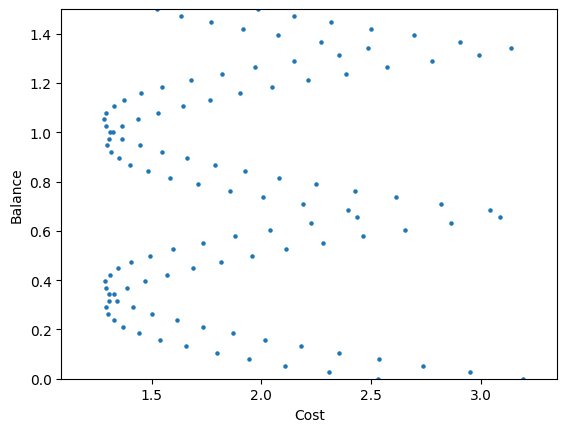

In [269]:
plt.scatter(*zip(*zz),s=5)
# plt.ylim(0.35,0.45)
plt.ylim(0,1.5)
plt.xlabel('Cost')
plt.ylabel('Balance')
plt.savefig('Highschool_all_sorted_cost_' + fairness_metric + '_dynamicprogramming_zoom.pdf')
plt.show()
